In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats

# import warnings
# # 屏蔽警告信息, 但在不以展示为目的的notebook中, 完全屏蔽不是个好习惯
# warnings.filterwarnings("ignore")
 
%matplotlib inline

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('max_colwidth', 1000)

在下载数据集时,观察到数据集是以多个空格(制表符)分割的,所以可以按照csv文件的读法读取.txt和csv本质都是文本型文件,只是后缀不同, 在安装程序的情况下,默认绑定打开程序可能不一致

In [2]:
train = pd.read_csv('./data/train.txt', sep = '\t', encoding = 'utf-8')
test = pd.read_csv('./data/test.txt', sep = '\t', encoding = 'utf-8')

# 1. 数据探索(EDA)

In [3]:
train.info()
print('-----------------------------------------')
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2888 entries, 0 to 2887
Data columns (total 39 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   V0      2888 non-null   float64
 1   V1      2888 non-null   float64
 2   V2      2888 non-null   float64
 3   V3      2888 non-null   float64
 4   V4      2888 non-null   float64
 5   V5      2888 non-null   float64
 6   V6      2888 non-null   float64
 7   V7      2888 non-null   float64
 8   V8      2888 non-null   float64
 9   V9      2888 non-null   float64
 10  V10     2888 non-null   float64
 11  V11     2888 non-null   float64
 12  V12     2888 non-null   float64
 13  V13     2888 non-null   float64
 14  V14     2888 non-null   float64
 15  V15     2888 non-null   float64
 16  V16     2888 non-null   float64
 17  V17     2888 non-null   float64
 18  V18     2888 non-null   float64
 19  V19     2888 non-null   float64
 20  V20     2888 non-null   float64
 21  V21     2888 non-null   float64
 22  

可以看出train和test相比,只多了一个target, 且数据集中不存在空值(不需要对null值做特殊处理)

In [4]:
train.head()

,V0,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,target
0,0.566,0.016,-0.143,0.407,0.452,-0.901,-1.812,-2.360,-0.436,-2.114,-0.940,-0.307,-0.073,0.550,-0.484,0.000,-1.707,-1.162,-0.573,-0.991,0.610,-0.400,-0.063,0.356,0.800,-0.223,0.796,0.168,-0.450,0.136,0.109,-0.615,0.327,-4.627,-4.789,-5.101,-2.608,-3.508,0.175
1,0.968,0.437,0.066,0.566,0.194,-0.893,-1.566,-2.360,0.332,-2.114,0.188,-0.455,-0.134,1.109,-0.488,0.000,-0.977,-1.162,-0.571,-0.836,0.588,-0.802,-0.063,0.357,0.801,-0.144,1.057,0.338,0.671,-0.128,0.124,0.032,0.600,-0.843,0.160,0.364,-0.335,-0.730,0.676
2,1.013,0.568,0.235,0.370,0.112,-0.797,-1.367,-2.360,0.396,-2.114,0.874,-0.051,-0.072,0.767,-0.493,-0.212,-0.618,-0.897,-0.564,-0.558,0.576,-0.477,-0.063,0.355,0.961,-0.067,0.915,0.326,1.287,-0.009,0.361,0.277,-0.116,-0.843,0.160,0.364,0.765,-0.589,0.633
3,0.733,0.368,0.283,0.165,0.599,-0.679,-1.200,-2.086,0.403,-2.114,0.011,0.102,-0.014,0.769,-0.371,-0.162,-0.429,-0.897,-0.574,-0.564,0.272,-0.491,-0.063,0.352,1.435,0.113,0.898,0.277,1.298,0.015,0.417,0.279,0.603,-0.843,-0.065,0.364,0.333,-0.112,0.206
4,0.684,0.638,0.260,0.209,0.337,-0.454,-1.073,-2.086,0.314,-2.114,-0.251,0.570,0.199,-0.349,-0.342,-0.138,-0.391,-0.897,-0.572,-0.394,0.106,0.309,-0.259,0.352,0.881,0.221,0.386,0.332,1.289,0.183,1.078,0.328,0.418,-0.843,-0.215,0.364,-0.280,-0.028,0.384


In [5]:
train.describe()

,V0,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,target
count,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000,2888.000000
mean,0.123048,0.056068,0.289720,-0.067790,0.012921,-0.558565,0.182892,0.116155,0.177856,-0.169452,0.034319,-0.364465,0.023177,0.195738,0.016081,0.096146,0.113505,-0.043458,0.055034,-0.114884,-0.186226,-0.056556,0.302893,0.155978,-0.021813,-0.051679,0.072092,0.272407,0.137712,0.097648,0.055477,0.127791,0.020806,0.007801,0.006715,0.197764,0.030658,-0.130330,0.126353
std,0.928031,0.941515,0.911236,0.970298,0.888377,0.517957,0.918054,0.955116,0.895444,0.953813,0.968272,0.858504,0.894092,0.922757,1.015585,1.033048,0.983128,0.655857,0.953466,1.108859,0.788511,0.781471,0.639186,0.978757,1.033403,0.915957,0.889771,0.270374,0.929899,1.061200,0.901934,0.873028,0.902584,1.006995,1.003291,0.985675,0.970812,1.017196,0.983966
min,-4.335000,-5.122000,-3.420000,-3.956000,-4.742000,-2.182000,-4.576000,-5.048000,-4.692000,-12.891000,-2.584000,-3.160000,-5.165000,-3.675000,-2.455000,-2.903000,-5.981000,-2.224000,-3.582000,-3.704000,-3.402000,-2.643000,-1.375000,-5.542000,-1.344000,-3.808000,-5.131000,-1.164000,-2.435000,-2.912000,-4.507000,-5.859000,-4.053000,-4.627000,-4.789000,-5.695000,-2.608000,-3.630000,-3.044000
25%,-0.297000,-0.226250,-0.313000,-0.652250,-0.385000,-0.853000,-0.310000,-0.295000,-0.159000,-0.390000,-0.420500,-0.803250,-0.419000,-0.398000,-0.668000,-0.662250,-0.300000,-0.366000,-0.367500,-0.987500,-0.675500,-0.517000,-0.063000,0.097250,-1.191000,-0.557250,-0.452000,0.157750,-0.455000,-0.664000,-0.283000,-0.170250,-0.407250,-0.499000,-0.290000,-0.202500,-0.413000,-0.798250,-0.350250
50%,0.359000,0.272500,0.386000,-0.044500,0.110000,-0.466000,0.388000,0.344000,0.362000,0.042000,0.157000,-0.112000,0.123000,0.289500,-0.161000,-0.000500,0.306000,0.165000,0.082000,-0.000500,-0.156500,-0.056500,0.216500,0.338000,0.095000,-0.076000,0.075000,0.325000,-0.447000,-0.023000,0.053500,0.299500,0.039000,-0.040000,0.160000,0.364000,0.137000,-0.185500,0.313000
75%,0.726000,0.599000,0.918250,0.624000,0.550250,-0.154000,0.831250,0.782250,0.726000,0.042000,0.619250,0.247000,0.616000,0.864250,0.829750,0.730000,0.774250,0.430000,0.513250,0.737250,0.304000,0.431500,0.872000,0.368250,0.931250,0.356000,0.644250,0.442000,0.730000,0.745250,0.488000,0.635000,0.557000,0.462000,0.273000,0.602000,0.644250,0.495250,0.793250
max,2.121000,1.918000,2.828000,2.457000,2.689000,0.489000,1.895000,1.918000,2.245000,1.335000,4.830000,1.455000,2.657000,2.475000,2.558000,4.314000,2.861000,2.023000,4.441000,3.431000,3.525000,2.259000,2.018000,1.906000,2.423000,7.284000,2.980000,0.925000,4.671000,4.580000,2.689000,2.013000,2.395000,5.465000,5.110000,2.324000,5.238000,3.000000,2.538000


In [6]:
test.describe()

,V0,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37
count,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000,1925.000000
mean,-0.184404,-0.083912,-0.434762,0.101671,-0.019172,0.838049,-0.274092,-0.173971,-0.266709,0.255114,-0.051709,0.547057,-0.034592,-0.293726,-0.024243,-0.144125,-0.170339,0.065445,-0.082423,0.172829,0.279249,0.085155,-0.454762,-0.233952,0.032064,0.077170,-0.108471,-0.408566,-0.206871,-0.146463,-0.083215,-0.191729,-0.030782,-0.011433,-0.009985,-0.296895,-0.046270,0.195735
std,1.073333,1.076670,0.969541,1.034925,1.147286,0.963043,1.054119,1.040101,1.085916,1.014394,1.043967,0.946800,1.139994,1.039017,0.975919,0.930072,1.001178,1.359768,1.060944,0.778954,1.199153,1.254135,1.242231,0.986066,0.947513,1.110116,1.137409,1.453598,1.064140,0.880593,1.126414,1.138454,1.130228,0.989732,0.995213,0.946896,1.040854,0.940599
min,-4.814000,-5.488000,-4.283000,-3.276000,-4.921000,-1.168000,-5.649000,-5.625000,-6.059000,-6.784000,-2.583000,-3.052000,-5.505000,-4.087000,-2.560000,-2.376000,-6.060000,-2.711000,-3.583000,-1.904000,-2.861000,-9.179000,-2.506000,-5.552000,-1.339000,-4.732000,-4.891000,-6.874000,-2.435000,-2.413000,-4.507000,-7.698000,-4.057000,-4.627000,-4.789000,-7.477000,-2.608000,-3.346000
25%,-0.664000,-0.451000,-0.978000,-0.644000,-0.497000,0.122000,-0.732000,-0.509000,-0.775000,-0.390000,-0.568000,-0.037000,-0.473000,-0.923000,-0.635000,-0.839000,-0.597000,-1.162000,-0.384000,-0.412000,-0.569000,-0.962000,-1.375000,-0.216000,-0.631000,-0.535000,-0.731000,-0.124000,-0.453000,-0.818000,-0.339000,-0.476000,-0.472000,-0.460000,-0.290000,-0.349000,-0.593000,-0.432000
50%,0.065000,0.195000,-0.267000,0.220000,0.118000,0.437000,-0.082000,0.018000,-0.004000,0.401000,0.079000,0.432000,0.132000,-0.204000,0.086000,-0.198000,-0.005000,-0.366000,0.075000,0.291000,0.107000,0.220000,-0.817000,-0.162000,0.093000,-0.026000,0.063000,0.179000,-0.445000,-0.199000,0.010000,0.100000,0.155000,-0.040000,0.160000,-0.270000,0.083000,0.152000
75%,0.549000,0.589000,0.278000,0.793000,0.610000,1.928000,0.457000,0.515000,0.482000,0.904000,0.634000,1.205000,0.583000,0.412000,0.576000,0.493000,0.464000,1.227000,0.438000,0.746000,0.966000,1.018000,0.314000,0.356000,0.800000,0.460000,0.682000,0.317000,-0.434000,0.468000,0.447000,0.471000,0.627000,0.419000,0.273000,0.364000,0.651000,0.797000
max,2.100000,2.120000,1.946000,2.603000,4.475000,3.176000,1.528000,1.394000,2.408000,1.766000,3.118000,2.949000,4.011000,2.587000,2.864000,3.073000,2.033000,3.085000,4.440000,2.196000,4.056000,4.343000,3.609000,1.354000,1.795000,6.616000,2.472000,0.786000,4.656000,3.022000,3.139000,1.428000,2.299000,5.465000,5.110000,1.671000,2.861000,3.021000


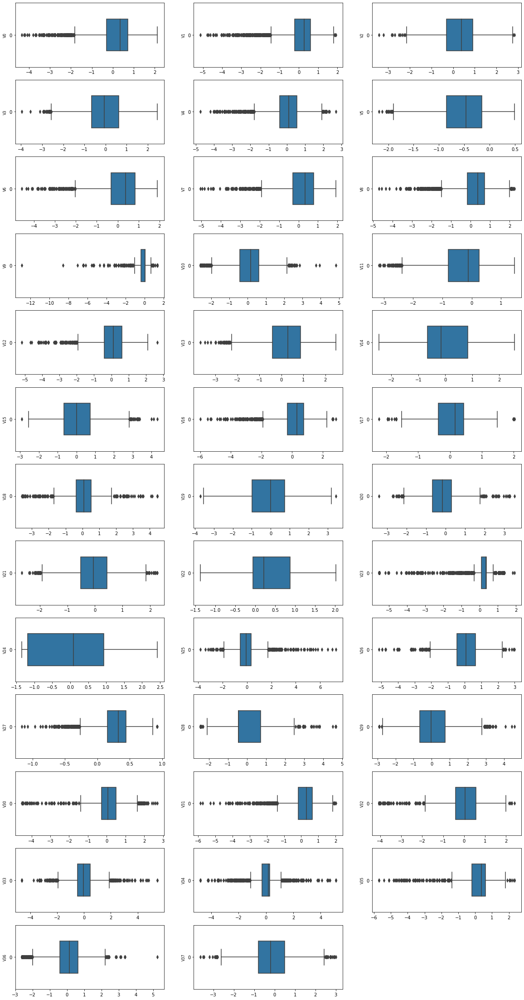

In [7]:
column = test.columns.tolist()  # 除了target外都分析一下
fig = plt.figure(figsize=(20, 40))  # 指定绘图对象宽度和高度
col_num = len(column)
for i in range(col_num):
    plt.subplot(13, 3, i + 1)  # 13行3列子图
    sns.boxplot(data = train[column[i]], orient="h", width=0.5)  # 箱式图
    plt.ylabel(column[i], fontsize=8)
plt.show()

查看数据是否为正态分布


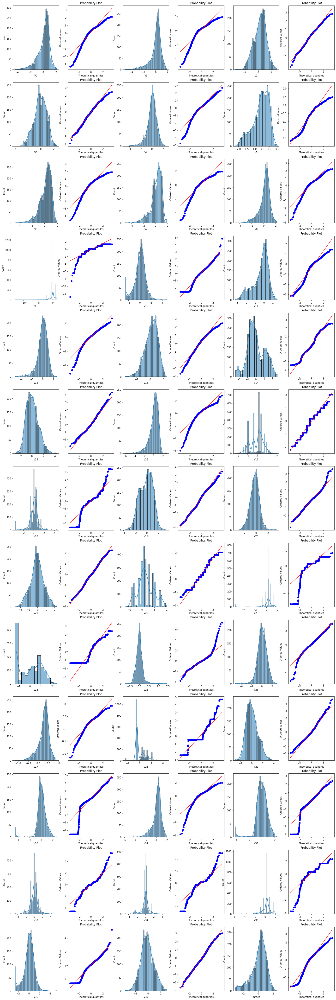

In [8]:
plt_cols = 6
plt.figure(figsize=(4*plt_cols,6*col_num))

column_include_y = train.columns.tolist()
i=0
for col in column_include_y:
    i+=1
    ax=plt.subplot(col_num + 1, plt_cols, i)
    sns.histplot(train[col], kde = True)
    
    i+=1
    ax=plt.subplot(col_num + 1,plt_cols,i)
    res = stats.probplot(train[col], plot=plt)
plt.show()

可以看到数据是接近正态分布的.若要在后续使用线性回归模型(线性回归要求数据为正态分布)而数据并不是正态分布的, 要先对数据使用z变换, 对数变换或box-cox变换等方法将其转换为拟正态分布

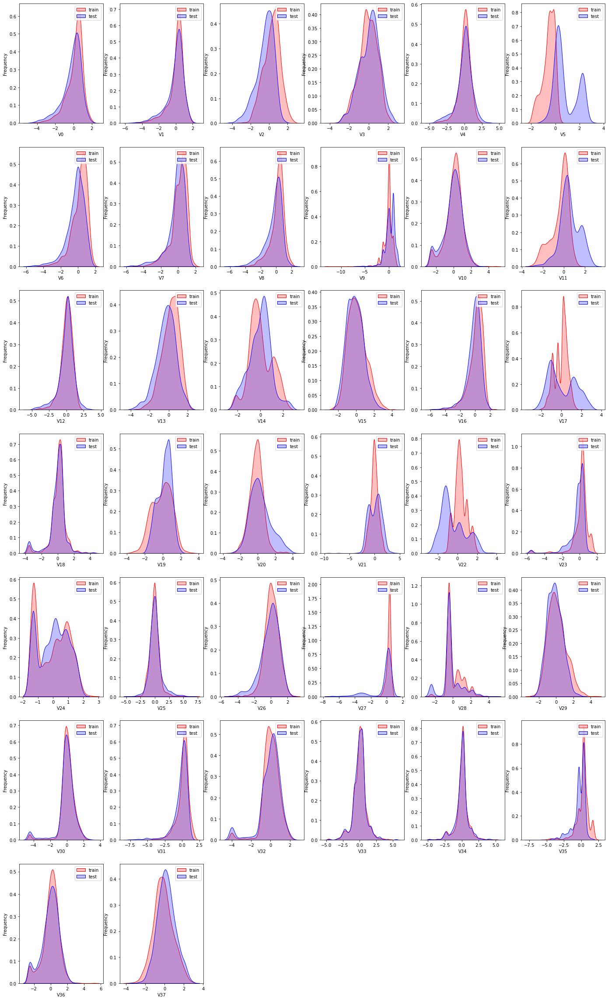

In [9]:
plt_cols = 6
plt.figure(figsize=(4*plt_cols,6*col_num))

i=0
for col in column:
    i+=1
    ax=plt.subplot(col_num, plt_cols, i)
    ax = sns.kdeplot(train[col], color="Red", shade=True)
    ax = sns.kdeplot(test[col], color="Blue", shade=True)
    ax.set_xlabel(col)
    ax.set_ylabel("Frequency")
    ax = ax.legend(["train","test"])
    

plt.show()

可视化训练集与测试集中数据差距较大的项,在后续应对这些项进行删除以提升模型泛化能力

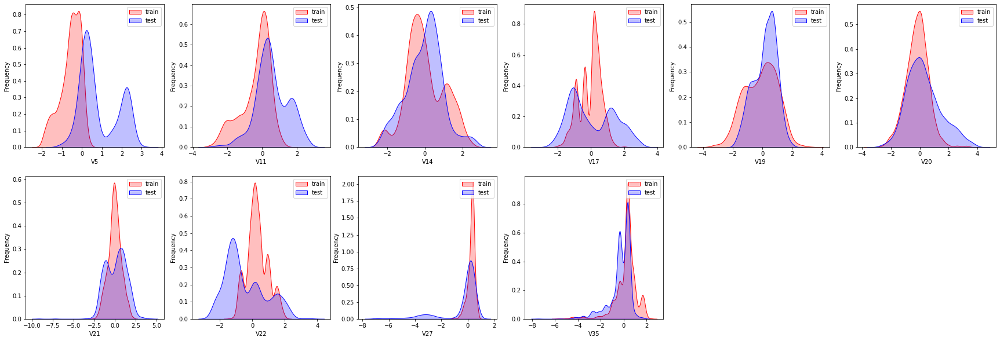

In [10]:
drop_col = 6
drop_row = 2

plt.figure(figsize=(5*drop_col,5*drop_row))

i=1
for col in ['V5','V11','V14','V17','V19','V20', 'V21', 'V22', 'V27','V35']:
    ax =plt.subplot(drop_row,drop_col,i)
    ax = sns.kdeplot(train[col], color="Red", shade=True)
    ax = sns.kdeplot(test[col], color="Blue", shade=True)
    ax.set_xlabel(col)
    ax.set_ylabel("Frequency")
    ax = ax.legend(["train","test"])
    
    i+=1
plt.show()

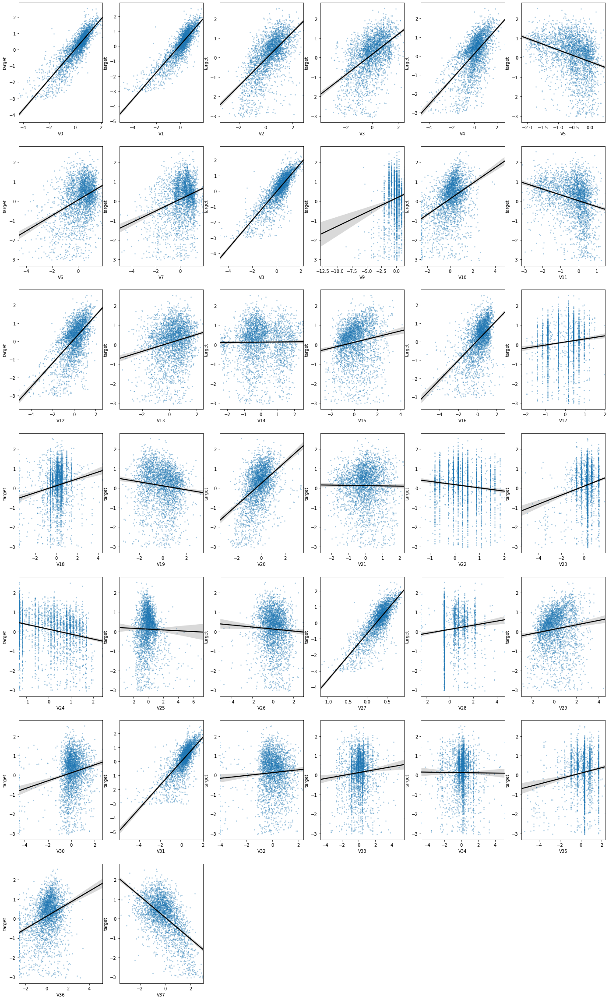

In [11]:
plt_cols = 6
plt.figure(figsize=(4*plt_cols,6*col_num))

i=0
for col in column:
    i+=1
    ax=plt.subplot(col_num, plt_cols, i)
    sns.regplot(x=col, y='target', data=train, ax=ax, 
                scatter_kws={'marker':'.','s':3,'alpha':0.3},
                line_kws={'color':'k'});
    plt.xlabel(col)
    plt.ylabel('target')
plt.show()

数据的相关性探索, 为了保险使用spearman系数(皮尔逊系数最好的使用场景是特征均符合正态分布) 进行计算

In [12]:
train_data = train.drop(['V5','V11','V13','V14','V17','V19','V20', 'V21', 'V22', 'V27','V35'], axis = 1)
test_data = test.drop(['V5','V11','V13','V14','V17','V19','V20', 'V21', 'V22', 'V27','V35'], axis = 1)
train_corr = train_data.corr(method = 'spearman')

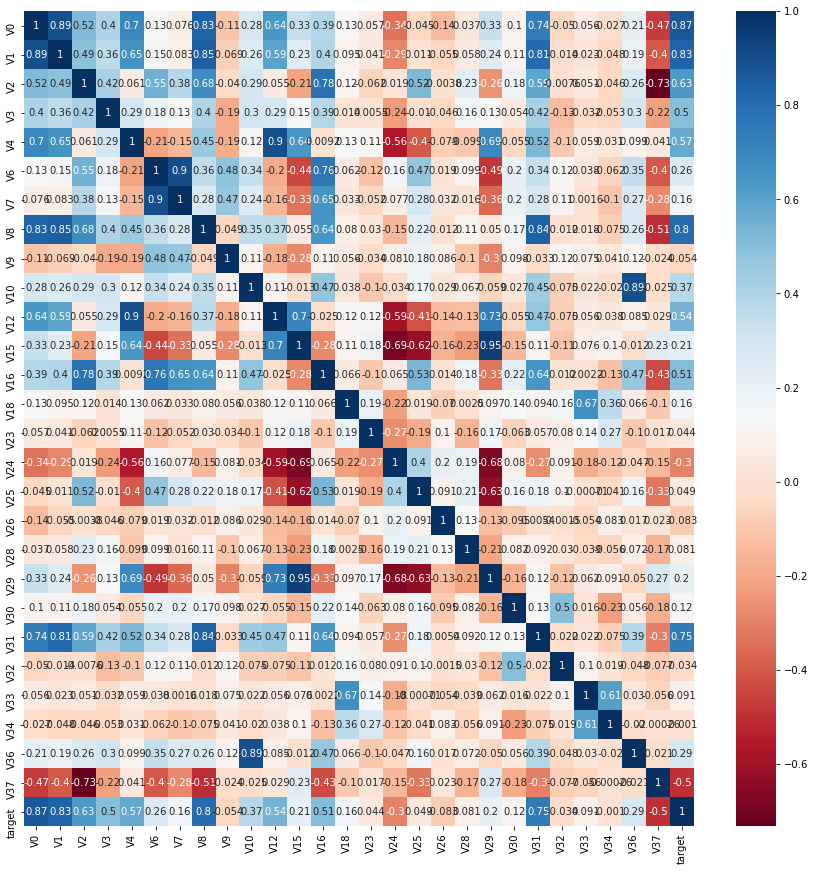

In [13]:
plt.figure(figsize=[15, 15])
sns.heatmap(train_corr,annot=True, cmap = plt.cm.RdBu)
plt.show()

# 特征工程

我们前面删除了一些在train和test中分布不一样的特征以提高模型泛化能力,现在将剩余的特征变成一个列表方便后续传入参数

In [14]:
current_columns = train_data.drop('target', axis = 1).columns.tolist()

前面发现了很多关联性极强的特征,需要对数据集做PCA降维.在PCA降维之前,需要进行归一化或标准化操作

In [15]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
scaler = scaler.fit(train[current_columns])
train_x = scaler.transform(train[current_columns])
test_x = scaler.transform(test[current_columns])

In [16]:
from sklearn.decomposition import PCA

pca = PCA(n_components=16)
train_x = pca.fit_transform(train_x)
test_x = pca.transform(test_x)

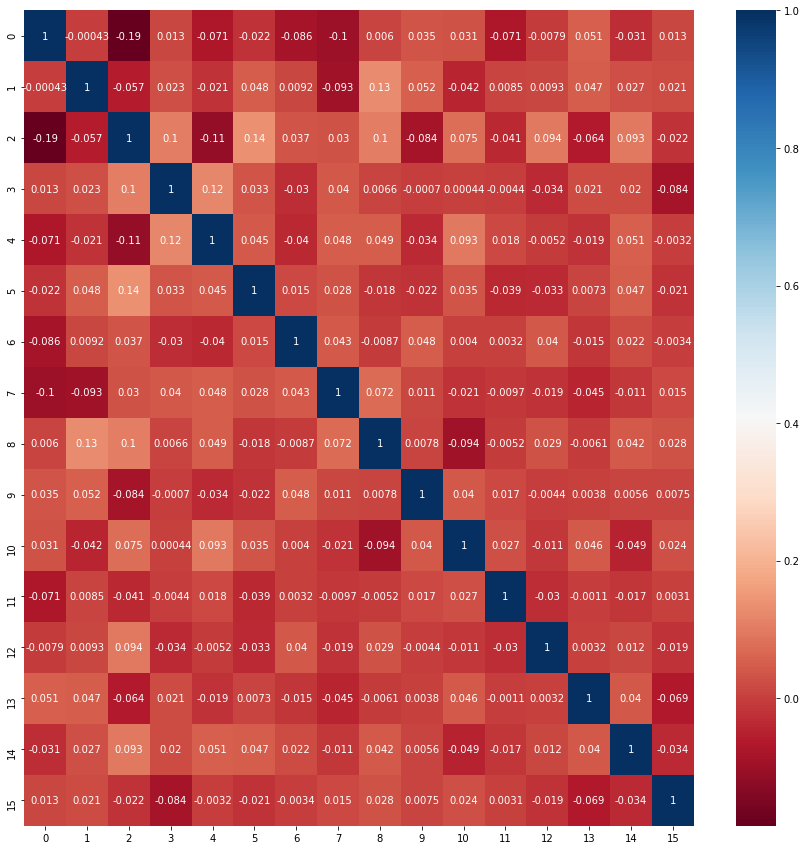

In [17]:
train_x_pca = pd.DataFrame(train_x)
plt.figure(figsize=[15, 15])
sns.heatmap(train_x_pca.corr(method = 'spearman'),annot=True, cmap = plt.cm.RdBu)
plt.show()

经过PCA后,自变量之间的过高的相关性被消除

# 模型建立

In [20]:
from sklearn.neighbors import KNeighborsRegressor  #K近邻回归
from sklearn.linear_model import LinearRegression # 线性回归
from sklearn.tree import DecisionTreeRegressor     #决策树回归
from sklearn.ensemble import RandomForestRegressor #随机森林回归
from sklearn.svm import SVR  #支持向量回归
from lightgbm import LGBMRegressor #lightGbm模型
from xgboost import XGBRegressor # xgb回归模型
from sklearn.metrics import mean_squared_error #评价指标
from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import cross_validate

In [21]:
#Machine Learning Algorithm (MLA) Selection and Initialization
MLA = [
    KNeighborsRegressor(n_neighbors=8),
    DecisionTreeRegressor(),
    RandomForestRegressor(),
    SVR(),
    XGBRegressor(),
    LGBMRegressor(),
    LinearRegression()
    ]

In [22]:
def get_score_df(n_splits, test_size, train_size, MLA, x, y, scoring, random_state = 0):
    cv_split = ShuffleSplit(n_splits = n_splits, test_size = test_size, train_size = train_size, random_state = random_state)
    score_name = 'MLA Test Score({})'.format(scoring)
    MLA_columns = ['MLA Name',
               score_name,'MLA Time']
    MLA_compare = pd.DataFrame(columns = MLA_columns)
    MLA_dic = dict()
    row_index = 0
    for alg in MLA:
        MLA_name = alg.__class__.__name__
        MLA_dic[MLA_name] = alg
        MLA_compare.loc[row_index, 'MLA Name'] = MLA_name
        cv_results = cross_validate(alg, x, y, cv = cv_split, scoring = scoring)
        MLA_compare.loc[row_index, 'MLA Time'] = cv_results['fit_time'].mean()
        MLA_compare.loc[row_index, score_name] = cv_results['test_score'].mean()   
        row_index += 1
    MLA_compare.sort_values(by = [score_name, 'MLA Time'], ascending = False, inplace = True)
    return MLA_compare, MLA_dic

In [23]:
model_compare, model_dic = get_score_df(10, 0.2, 0.8, MLA, train_x, train['target'], 'neg_mean_squared_error')

In [24]:
model_compare

,MLA Name,MLA Test Score(neg_mean_squared_error),MLA Time
6,LinearRegression,-0.137968,0.002692
5,LGBMRegressor,-0.138299,0.143018
3,SVR,-0.149205,0.275165
2,RandomForestRegressor,-0.152567,1.755608
4,XGBRegressor,-0.160355,0.425164
0,KNeighborsRegressor,-0.176682,0.000898
1,DecisionTreeRegressor,-0.305604,0.034217


In [25]:
models = model_compare['MLA Name'][:3].tolist()
model_touse = list()
for model in models:
    model_touse.append(model_dic[model])

In [26]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

def average_res(models, train_x, train_y, target_x):
    base_arr = []
    col_index = 0
    for model in models:
        model.fit(train_x, train_y)
        cur_res = model.predict(target_x)
        base_arr.append(cur_res)
    base_arr = np.array(base_arr)
    res = np.mean(base_arr, axis = 0)
    return res

scores = []
for rd in range(10):
    train_data, test_data, train_target, test_target = train_test_split(train_x, train['target'], test_size = 0.2, random_state = rd)
    res = average_res(model_touse, train_data, train_target, test_data)
    cur_score = mean_squared_error(test_target, res)
    scores.append(cur_score)

In [27]:
print(sum(scores)/len(scores))

0.12297331515759755


In [28]:
result = average_res(model_touse, train_x, train['target'], test_x)
res = pd.DataFrame(result)
res.to_csv('res.txt', index = False, header = False)